<a href="https://colab.research.google.com/github/selyraa/2141720005-pcvk-2023/blob/main/week-09/JS09_Morfologi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Praktikum 9 - Morfologi
- Erosi
- Dilasi
- Opening
- Closing
- Transformasi
- Top-hat dan Bottom-hat
- Skeleton
- Thickening

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [56]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image as im
import os

## 1. Dilasi Tanpa Library

(-0.5, 286.5, 109.5, -0.5)

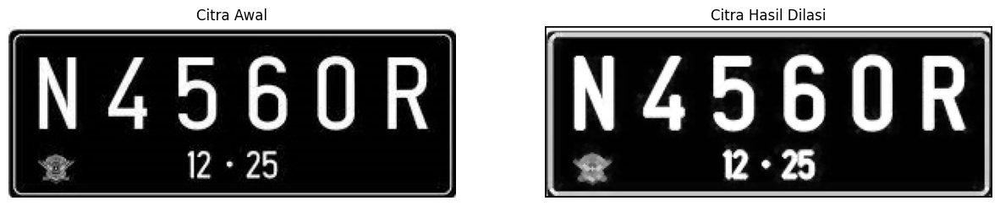

In [25]:
def dilasi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat SED (Structuring Element Dilasi) berbentuk cross 3x3
    sed = np.array([[0, 1, 0],
                    [1, 1, 1],
                    [0, 1, 0]], dtype=np.uint8)

    # Buat citra hasil dilasi dengan inisialisasi citra yang semuanya hitam
    dilated_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan dilasi
    for i in range(1, height - 1):
        for j in range(1, width - 1):
            # Ambil bagian citra yang sesuai dengan ukuran SED
            roi = image[i-1:i+2, j-1:j+2]

            # Lakukan operasi dilasi dengan mengalikan SED dengan ROI dan mengambil nilai maksimum
            dilated_image[i, j] = np.max(roi * sed)

    return dilated_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi dilasi
dilated_image = dilasi(image)
dilated_image_rgb = cv2.cvtColor(dilated_image, cv2.COLOR_GRAY2RGB)
plt.figure(figsize=(15,15))
plt.subplot(121),plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)),plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122),plt.imshow(dilated_image_rgb),plt.title('Citra Hasil Dilasi')
plt.axis('off')


## 2. Dilasi dengan Library Morphology dari OpenCV

(-0.5, 286.5, 109.5, -0.5)

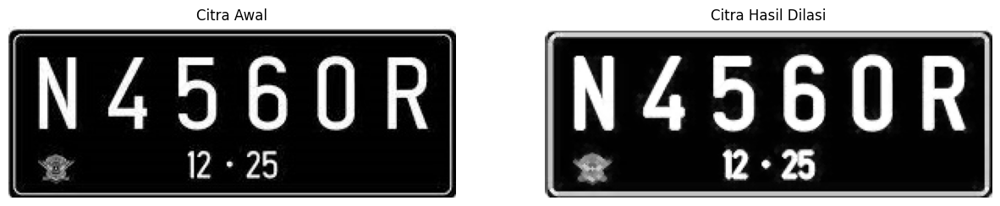

In [58]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat SED (Structuring Element Dilasi) berbentuk cross 3x3
sed = cv2.getStructuringElement(cv2.MORPH_CROSS, (3, 3))

# Lakukan operasi dilasi
dilated_image = cv2.dilate(image, sed)
dilated_image_rgb = cv2.cvtColor(dilated_image, cv2.COLOR_GRAY2RGB)
plt.figure(figsize=(15,15))
plt.subplot(121),plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)),plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122),plt.imshow(dilated_image_rgb),plt.title('Citra Hasil Dilasi')
plt.axis('off')

## 3. Erosi Tanpa Library

(-0.5, 286.5, 109.5, -0.5)

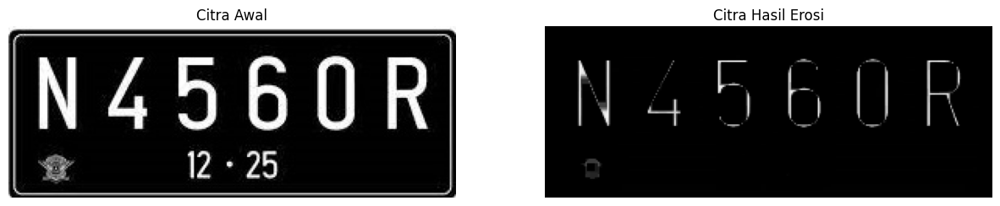

In [71]:
def erosi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Erosi (SE) berbentuk square 5x5
    se = np.ones((5, 5), dtype=np.uint8)

    # Buat citra hasil erosi dengan inisialisasi citra yang semuanya hitam
    eroded_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan erosi
    for i in range(2, height - 2):
        for j in range(2, width - 2):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-2:i+3, j-2:j+3]
            product = roi*se
            eroded_image[i,j] = np.min(product)
    return eroded_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi erosi
eroded_image = erosi(image)
eroded_image_rgb = (cv2.cvtColor(eroded_image, cv2.COLOR_GRAY2RGB))
plt.figure(figsize=(15,15))
plt.subplot(121),plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)),plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122),plt.imshow(eroded_image_rgb),plt.title('Citra Hasil Erosi')
plt.axis('off')

## Erosi tanpa Library dengan SE Square 5 x 5

(-0.5, 286.5, 109.5, -0.5)

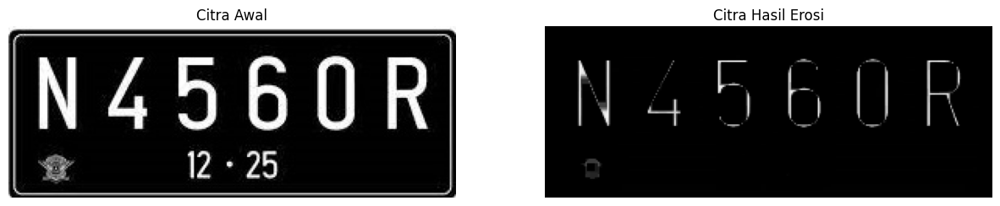

In [28]:
def erosi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Erosi (SE) berbentuk square 5x5
    se = np.ones((5, 5), dtype=np.uint8)

    # Buat citra hasil erosi dengan inisialisasi citra yang semuanya hitam
    eroded_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan erosi
    for i in range(2, height - 2):
        for j in range(2, width - 2):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-2:i+3, j-2:j+3]
            product = roi*se
            eroded_image[i,j] = np.min(roi)
    return eroded_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi erosi
eroded_image = erosi(image)
eroded_image_rgb = (cv2.cvtColor(eroded_image, cv2.COLOR_GRAY2RGB))
plt.figure(figsize=(15,15))
plt.subplot(121),plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)),plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122),plt.imshow(eroded_image_rgb),plt.title('Citra Hasil Erosi')
plt.axis('off')

## 4. Erosi dengan Library Morphology dari OpenCV

(-0.5, 286.5, 109.5, -0.5)

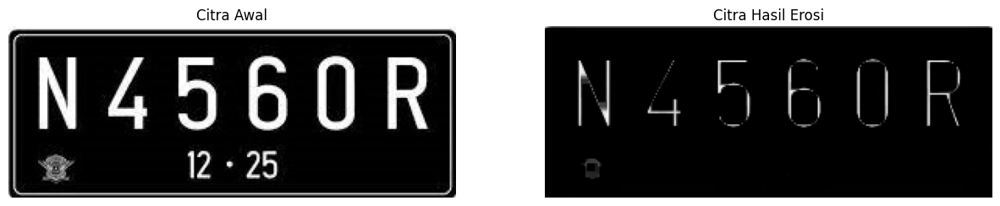

In [29]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)
kernel = np.ones((5,5), np.uint8)

erosion = cv2.morphologyEx(image, cv2.MORPH_ERODE, kernel)
erosion_rgb = cv2.cvtColor(erosion, cv2.COLOR_GRAY2RGB)
plt.figure(figsize=(15,15))
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(erosion_rgb), plt.title('Citra Hasil Erosi')
plt.axis('off')

## 5. Opening Tanpa Library dengan SE Square 3 x 3

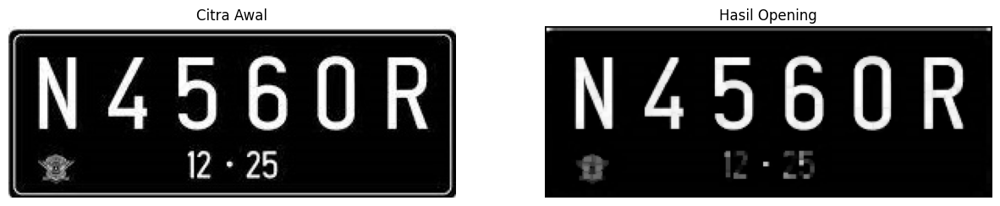

In [81]:
def erosi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Erosi (SE) berbentuk square 5x5
    se = np.ones((3, 3), dtype=np.uint8)

    # Buat citra hasil erosi dengan inisialisasi citra yang semuanya hitam
    eroded_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan erosi
    for i in range(1, height - 1):
        for j in range(1, width - 1):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-1:i+2, j-1:j+2]
            product = roi*se
            eroded_image[i,j] = np.min(product)
    return eroded_image

def dilasi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Dilasi (SE) berbentuk square 3x3
    se = np.ones((3, 3), dtype=np.uint8)

    # Buat citra hasil dilasi dengan inisialisasi citra yang semuanya hitam
    dilated_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan dilasi
    for i in range(1, height - 1):
        for j in range(1, width - 1):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-1:i+2, j-1:j+2]
            dilated_image[i, j] = np.max(roi * se)

    return dilated_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi erosi
eroded_image = erosi(image)

# Panggil fungsi dilasi pada hasil erosi
opened_image = dilasi(eroded_image)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil opening
plt.subplot(121),plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)),plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122),plt.imshow(opened_image, cmap='gray'),plt.title('Hasil Opening')
plt.axis('off')

plt.show()


## 6. Opening dengan Library Morphology dari OpenCV dengan SE Square 3 x 3

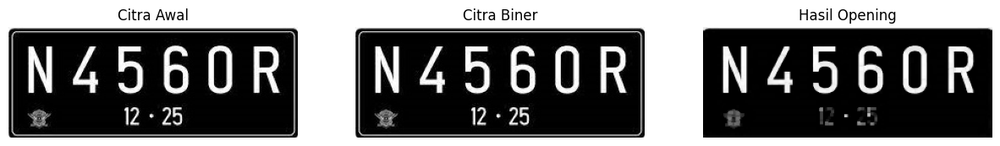

In [31]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk square 3x3
se = np.ones((3, 3), dtype=np.uint8)

# Lakukan erosi dengan SE 3x3
eroded_image = cv2.erode(image, se, iterations=1)

# Lakukan dilasi dengan SE 3x3 pada hasil erosi
opened_image = cv2.dilate(eroded_image, se, iterations=1)

image_rgb = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil opening
plt.subplot(131), plt.imshow(image_rgb), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(132), plt.imshow(image_rgb, cmap='binary'), plt.title('Citra Biner')
plt.axis('off')
plt.subplot(133), plt.imshow(opened_image, cmap='gray'), plt.title('Hasil Opening')
plt.axis('off')

plt.show()


## 7. Closing Tanpa Library dengan SE Square 3 x 3

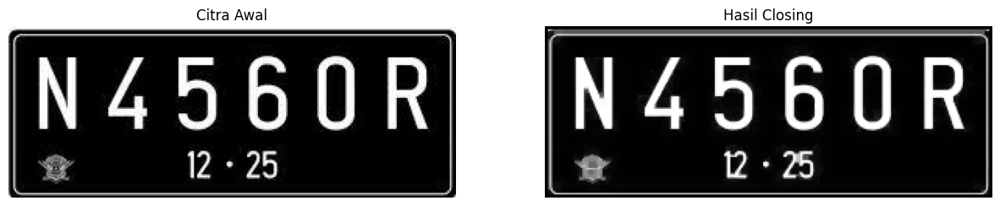

In [75]:
def dilasi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Dilasi (SE) berbentuk square 3x3
    se = np.ones((3, 3), dtype=np.uint8)

    # Buat citra hasil dilasi dengan inisialisasi citra yang semuanya hitam
    dilated_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan dilasi
    for i in range(1, height - 1):
        for j in range(1, width - 1):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-1:i+2, j-1:j+2]
            dilated_image[i, j] = np.max(roi * se)
    return dilated_image

def erosi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Erosi (SE) berbentuk square 5x5
    se = np.ones((3, 3), dtype=np.uint8)

    # Buat citra hasil erosi dengan inisialisasi citra yang semuanya hitam
    eroded_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan erosi
    for i in range(1, height - 1):
        for j in range(1, width - 1):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-1:i+2, j-1:j+2]
            product = roi*se
            eroded_image[i,j] = np.min(product)
    return eroded_image


# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi dilasi
dilated_image = dilasi(image)

# Panggil fungsi dilasi pada hasil erosi
closing_image = erosi(dilated_image)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil opening
plt.subplot(121),plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)),plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122),plt.imshow(closing_image, cmap='gray'),plt.title('Hasil Closing')
plt.axis('off')

plt.show()


## 8. Closing dengan Library Morphology dari OpenCV dengan SE Square 3 x 3

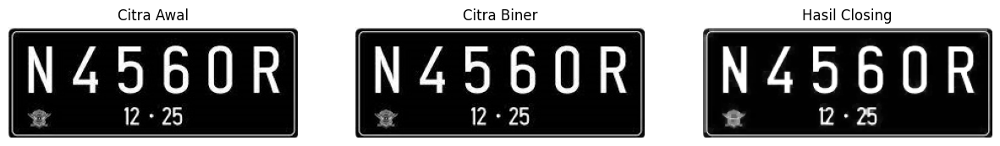

In [33]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk square 3x3
se = np.ones((3, 3), dtype=np.uint8)

# Lakukan erosi dengan SE 3x3
dilated_image = cv2.dilate(image, se, iterations=1)

# Lakukan dilasi dengan SE 3x3 pada hasil erosi
closing_image = cv2.erode(dilated_image, se, iterations=1)

image_rgb = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil opening
plt.subplot(131), plt.imshow(image_rgb), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(132), plt.imshow(image_rgb, cmap='binary'), plt.title('Citra Biner')
plt.axis('off')
plt.subplot(133), plt.imshow(closing_image, cmap='gray'), plt.title('Hasil Closing')
plt.axis('off')

plt.show()


## 9. Dilasi dengan SE Cross **3 x 3 dan 5 x 5**

## 3 x 3

(-0.5, 286.5, 109.5, -0.5)

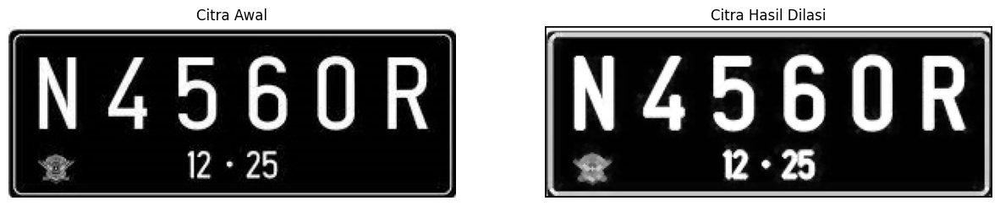

In [34]:
def dilasi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat SED (Structuring Element Dilasi) berbentuk cross 3x3
    sed = np.array([[0, 1, 0],
                    [1, 1, 1],
                    [0, 1, 0]], dtype=np.uint8)

    # Buat citra hasil dilasi dengan inisialisasi citra yang semuanya hitam
    dilated_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan dilasi
    for i in range(1, height - 1):
        for j in range(1, width - 1):
            # Ambil bagian citra yang sesuai dengan ukuran SED
            roi = image[i-1:i+2, j-1:j+2]

            # Lakukan operasi dilasi dengan mengalikan SED dengan ROI dan mengambil nilai maksimum
            dilated_image[i, j] = np.max(roi * sed)

    return dilated_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi dilasi
dilated_image = dilasi(image)
dilated_image_rgb = cv2.cvtColor(dilated_image, cv2.COLOR_GRAY2RGB)
plt.figure(figsize=(15,15))
plt.subplot(121),plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)),plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122),plt.imshow(dilated_image_rgb),plt.title('Citra Hasil Dilasi')
plt.axis('off')


## 5 x 5

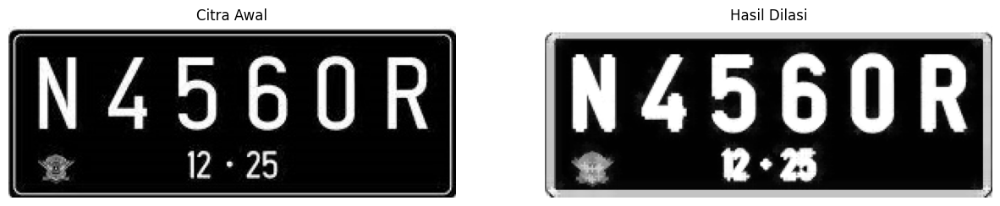

In [35]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk cross 5x5
se = np.array([[0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0],
              [1, 1, 1, 1, 1],
              [0, 0, 1, 0, 0],
              [0, 0, 1, 0, 0]], dtype=np.uint8)

# Lakukan dilasi dengan SE cross 5x5
dilated_image = cv2.dilate(image, se, iterations=1)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil dilasi
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(dilated_image, cmap='gray'), plt.title('Hasil Dilasi')
plt.axis('off')

plt.show()


## 10. Dilasi dengan SE Circular **3 x 3 dan 5 x 5**

## 3 x 3

(-0.5, 286.5, 109.5, -0.5)

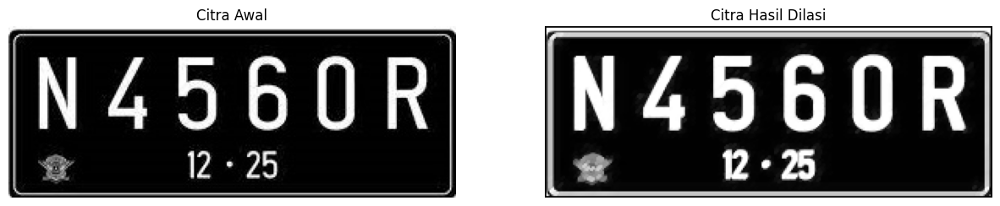

In [36]:
def dilasi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat SED (Structuring Element Dilasi) berbentuk cross 3x3
    sed = np.array([[0, 1, 1],
                    [1, 1, 1],
                    [1, 1, 0]], dtype=np.uint8)

    # Buat citra hasil dilasi dengan inisialisasi citra yang semuanya hitam
    dilated_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan dilasi
    for i in range(1, height - 1):
        for j in range(1, width - 1):
            # Ambil bagian citra yang sesuai dengan ukuran SED
            roi = image[i-1:i+2, j-1:j+2]

            # Lakukan operasi dilasi dengan mengalikan SED dengan ROI dan mengambil nilai maksimum
            dilated_image[i, j] = np.max(roi * sed)

    return dilated_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi dilasi
dilated_image = dilasi(image)
dilated_image_rgb = cv2.cvtColor(dilated_image, cv2.COLOR_GRAY2RGB)
plt.figure(figsize=(15,15))
plt.subplot(121),plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)),plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122),plt.imshow(dilated_image_rgb),plt.title('Citra Hasil Dilasi')
plt.axis('off')


## 5 x 5

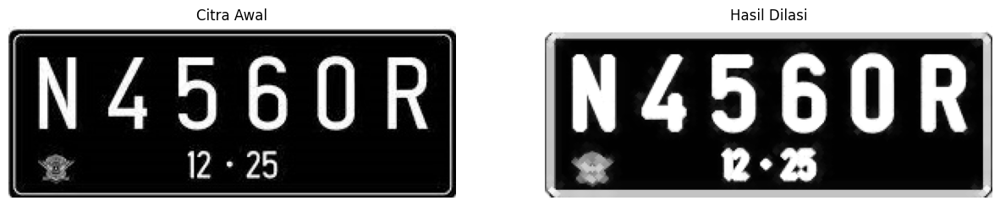

In [37]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk cross 5x5
se = np.array([[0, 0, 1, 0, 0],
              [0, 1, 1, 1, 0],
              [1, 1, 1, 1, 1],
              [0, 1, 1, 1, 0],
              [0, 0, 1, 0, 0]], dtype=np.uint8)

# Lakukan dilasi dengan SE cross 5x5
dilated_image = cv2.dilate(image, se, iterations=1)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil dilasi
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(dilated_image, cmap='gray'), plt.title('Hasil Dilasi')
plt.axis('off')

plt.show()


## 11. Erosi dengan SE Rectangle **3 x 5 dan 5 x 7**

## 3 x 5

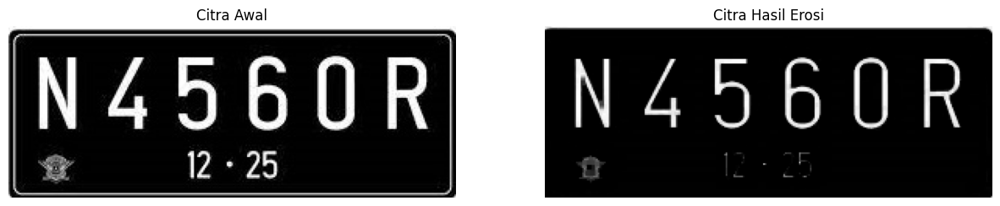

In [38]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk Rectangle 3x5
se = np.array([[0, 0, 1, 1, 1],
              [0, 0, 1, 1, 1],
              [0, 0, 1, 1, 1]], dtype=np.uint8)

# Lakukan erosi dengan SE Rectangle 3x5
eroded_image = cv2.erode(image, se, iterations=1)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil erosi
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(eroded_image, cmap='gray'), plt.title('Citra Hasil Erosi')
plt.axis('off')

plt.show()


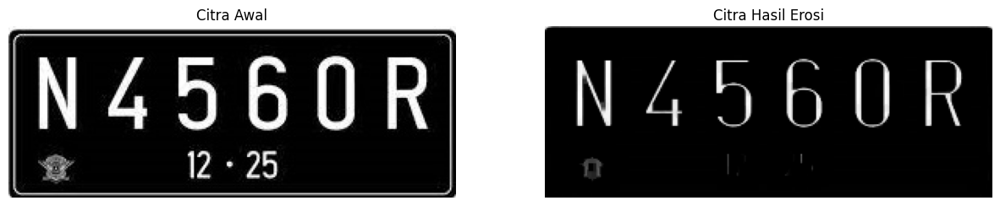

In [39]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk circular 3x3
se = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 5))

# Lakukan dilasi dengan SE circular 3x3
eroded_image = cv2.erode(image, se, iterations=1)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil dilasi
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(eroded_image, cmap='gray'), plt.title('Citra Hasil Erosi')
plt.axis('off')

plt.show()


## 5 x 7

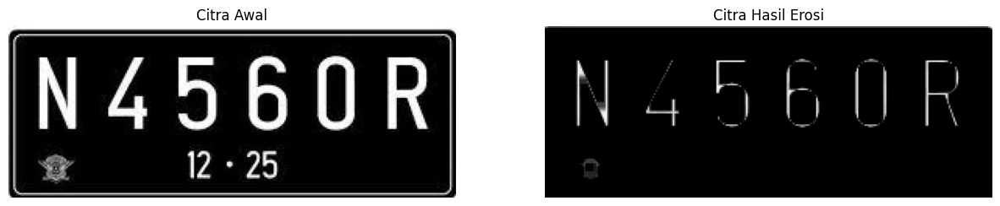

In [24]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk Rectangle 3x5
se = np.array([[0, 0, 1, 1, 1, 1, 1],
              [0, 0, 1, 1, 1, 1, 1],
              [0, 0, 1, 1, 1, 1, 1],
              [0, 0, 1, 1, 1, 1, 1],
              [0, 0, 1, 1, 1, 1, 1]], dtype=np.uint8)

# Lakukan erosi dengan SE Rectangle 3x5
eroded_image = cv2.erode(image, se, iterations=1)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil erosi
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(eroded_image, cmap='gray'), plt.title('Citra Hasil Erosi')
plt.axis('off')

plt.show()


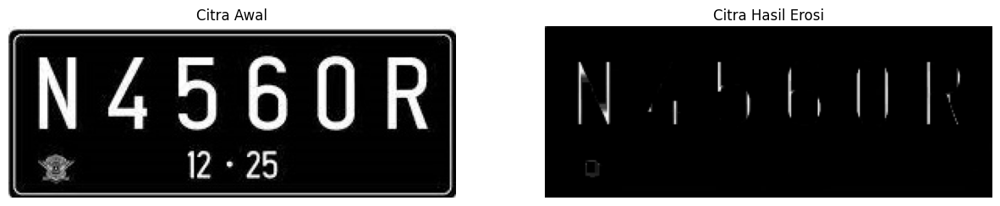

In [23]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk circular 3x3
se = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 7))

# Lakukan dilasi dengan SE circular 3x3
eroded_image = cv2.erode(image, se, iterations=1)
plt.figure(figsize=(15,15))
# Menampilkan citra awal dan hasil dilasi
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(eroded_image, cmap='gray'), plt.title('Citra Hasil Erosi')
plt.axis('off')

plt.show()


## 12. Erosi dengan SE Line Vertikal **3 dan 5**

## Citra plat nomor

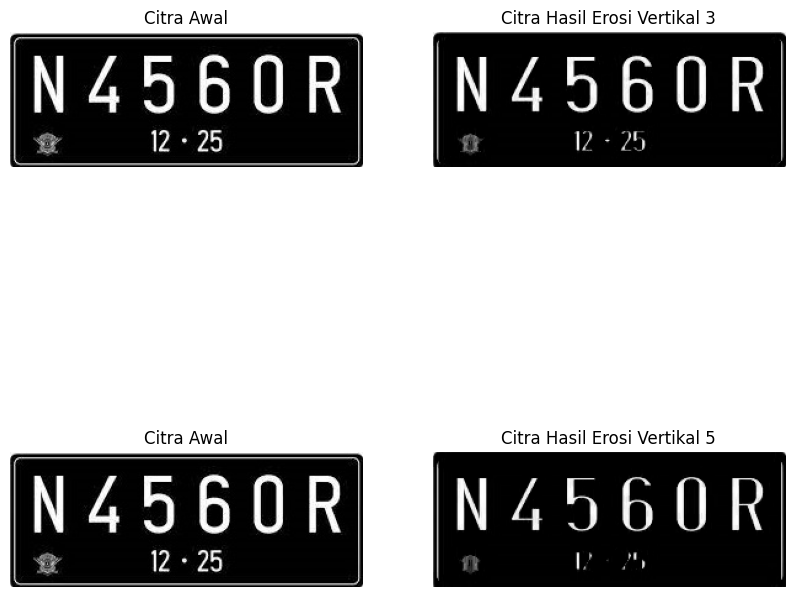

In [22]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk Line Vertikal 3
se3 = np.array([[1],
               [1],
               [1]], dtype=np.uint8)

# Buat Structuring Element (SE) berbentuk Line Vertikal 5
se5 = np.array([[1],
               [1],
               [1],
               [1],
               [1]], dtype=np.uint8)

# Lakukan erosi dengan SE Line Vertikal 3
eroded_image3 = cv2.erode(image, se3, iterations=1)

# Lakukan erosi dengan SE Line Vertikal 5
eroded_image5 = cv2.erode(image, se5, iterations=1)
plt.figure(figsize=(10,10))
# Menampilkan citra awal dan hasil erosi
plt.subplot(221), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(222), plt.imshow(eroded_image3, cmap='gray'), plt.title('Citra Hasil Erosi Vertikal 3')
plt.axis('off')
plt.subplot(223), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(224), plt.imshow(eroded_image5, cmap='gray'), plt.title('Citra Hasil Erosi Vertikal 5')
plt.axis('off')

plt.show()


## Citra j

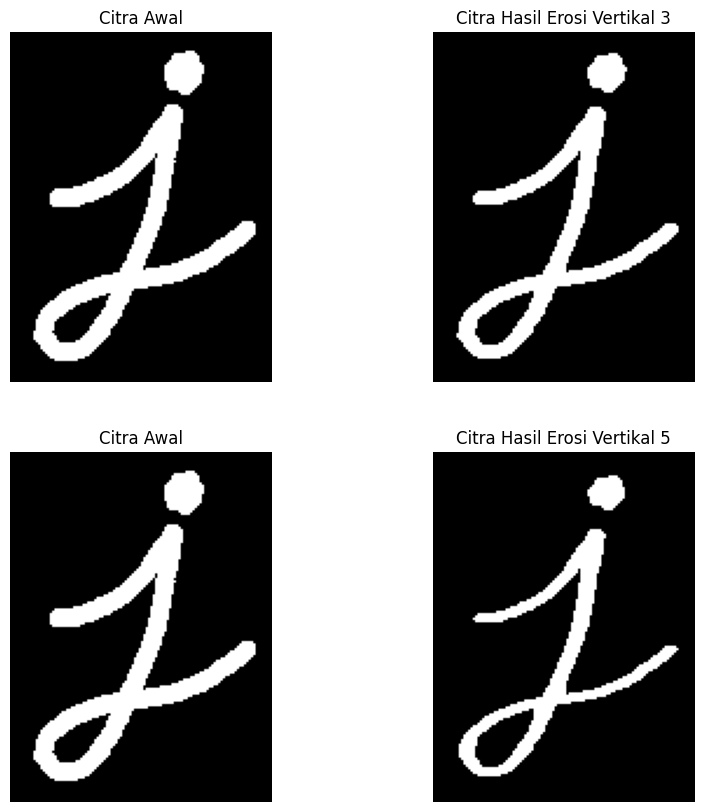

In [21]:
# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/j.png', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk Line Vertikal 3
se3 = np.array([[1],
               [1],
               [1]], dtype=np.uint8)

# Buat Structuring Element (SE) berbentuk Line Vertikal 5
se5 = np.array([[1],
               [1],
               [1],
               [1],
               [1]], dtype=np.uint8)

# Lakukan erosi dengan SE Line Vertikal 3
eroded_image3 = cv2.erode(image, se3, iterations=1)

# Lakukan erosi dengan SE Line Vertikal 5
eroded_image5 = cv2.erode(image, se5, iterations=1)
plt.figure(figsize=(10,10))

# Menampilkan citra awal dan hasil erosi
plt.subplot(221), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(222), plt.imshow(eroded_image3, cmap='gray'), plt.title('Citra Hasil Erosi Vertikal 3')
plt.axis('off')
plt.subplot(223), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(224), plt.imshow(eroded_image5, cmap='gray'), plt.title('Citra Hasil Erosi Vertikal 5')
plt.axis('off')

plt.show()


## 13. TopHat
TopHat akan mengurangi citra asli dengan hasil opening (erosi >> dilasi). Operasi ini akan mengekstrak objek-objek kecil yang mungkin tidak terlihat dengan jelas dalam citra asli. Dengan mengurangkan citra opening dari citra asli, kita dapat mengisolasi objek-objek ini. Hasilnya adalah citra yang hanya berisi objek-objek kecil tersebut.

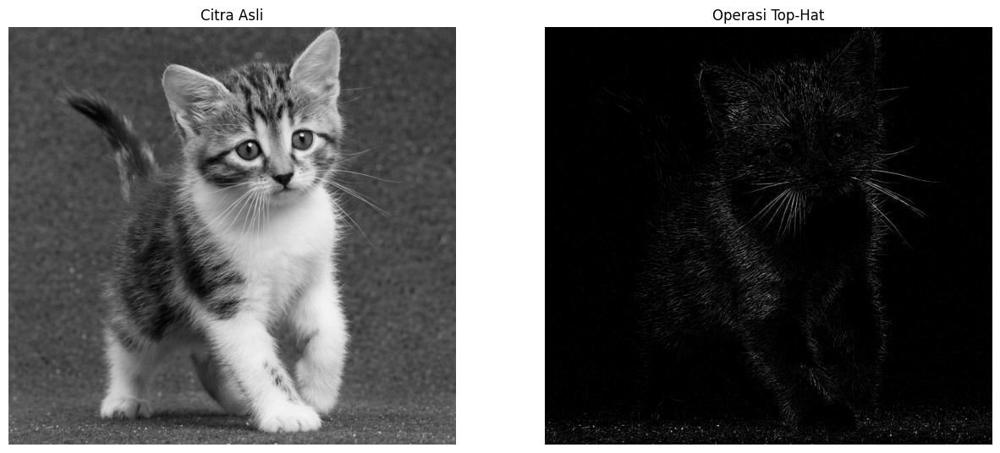

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/kitten01.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk square 3x3
se = np.ones((3, 3), dtype=np.uint8)

# Lakukan operasi opening pada citra
opened_image = cv2.morphologyEx(image, cv2.MORPH_OPEN, se)

# Hitung operasi top-hat
tophat_image = cv2.subtract(image, opened_image)
plt.figure(figsize=(15,15))
# Menampilkan citra asli dan hasil operasi top-hat
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Asli')
plt.axis('off')
plt.subplot(122), plt.imshow(tophat_image, cmap='gray'), plt.title('Operasi Top-Hat')
plt.axis('off')

plt.show()


## 14. BlackHat
BlackHat akan mengurangi hasil closing (dilasi >> erosi) dengan citra asli. Operasi ini digunakan untuk mengekstrak unsur-unsur latar belakang yang kecil atau fitur yang lebih gelap dalam citra. Hasil dari operasi BlackHat adalah citra yang hanya berisi unsur-unsur latar belakang yang lebih gelap.

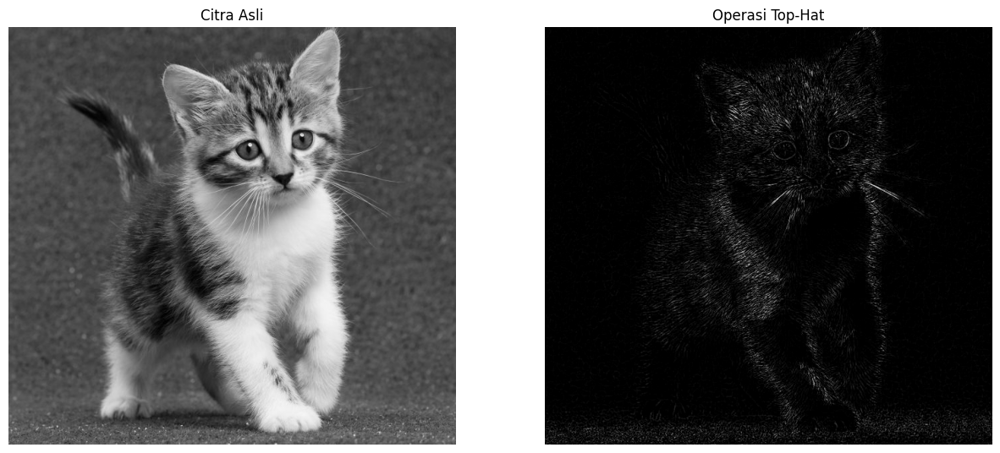

In [18]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/kitten01.jpg', cv2.IMREAD_GRAYSCALE)

# Buat Structuring Element (SE) berbentuk square 3x3
se = np.ones((3, 3), dtype=np.uint8)

# Lakukan operasi opening pada citra
closed_image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, se)

# Hitung operasi top-hat
blackhat_image = cv2.subtract(closed_image, image)

plt.figure(figsize=(15,15))
# Menampilkan citra asli dan hasil operasi top-hat
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Asli')
plt.axis('off')
plt.subplot(122), plt.imshow(blackhat_image, cmap='gray'), plt.title('Operasi Top-Hat')
plt.axis('off')

plt.show()


## 15. Skeleton

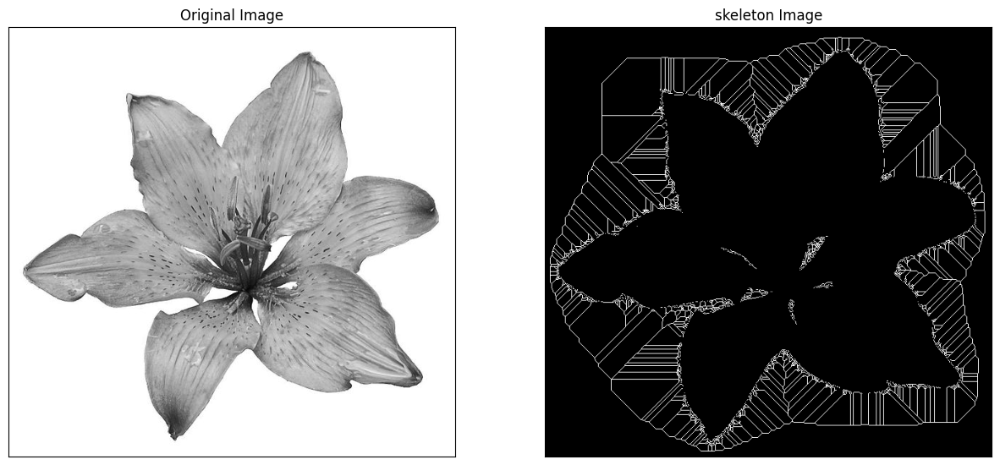

In [17]:
from skimage import filters
from skimage.morphology import skeletonize

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/lily.jpg', cv2.IMREAD_GRAYSCALE)

binary = image > filters.threshold_triangle(image)

# true false to one
binary_cp = binary.copy()
binary_cp[binary_cp == True] = 1
binary_cp[binary_cp == False] = 0

# skeletonize image
skeleton = skeletonize(binary_cp)

# print images
plt.figure(figsize=(15,15))

plt.subplot(121),plt.imshow(image,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(122),plt.imshow(skeleton,cmap = 'gray')
plt.title('skeleton Image'), plt.xticks([]), plt.yticks([])

# plt.savefig("binary and bin_skeleton.png")
plt.show()

## 16. Skeleton Inverse

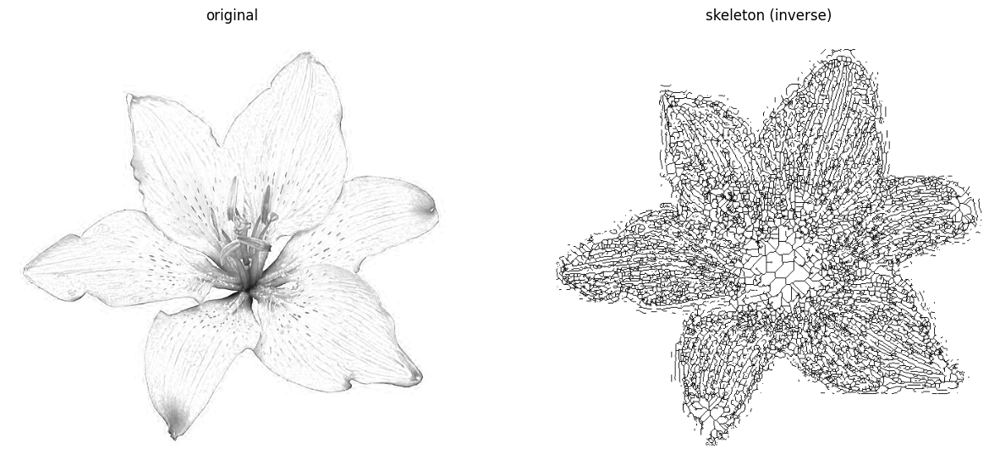

In [53]:
from skimage import io
from matplotlib import pyplot as plt
from skimage import filters
from skimage.morphology import skeletonize

# read image
img = io.imread('/content/drive/MyDrive/PCVK/Images/lily.jpg')[...,0]

# Note: we want the black bits to be True, so use <
binary = img < filters.threshold_triangle(img)

# skeletonize image
skeleton = skeletonize(binary)

# print images
fig, ax = plt.subplots(1, 2, figsize=(15, 15))

ax[0].imshow(img, cmap='gray')
ax[0].set_title('original')
ax[0].set_axis_off()

# note the reversed colormap, gray_r
ax[1].imshow(skeleton, cmap='gray_r')
ax[1].set_title('skeleton (inverse)')
ax[1].set_axis_off()
plt.show()

## 17. Thickening

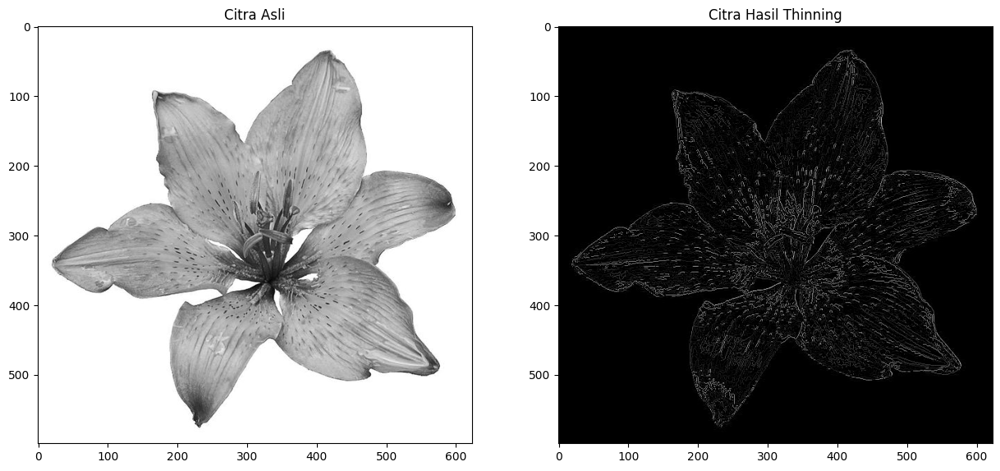

In [55]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Baca citra biner
binary_image = cv2.imread('/content/drive/MyDrive/PCVK/Images/lily.jpg', cv2.IMREAD_GRAYSCALE)

# Fungsi operasi thinning
def thinning(image):
    # Fungsi untuk melakukan satu langkah thinning
    def thinning_step(image, mask):
        eroded = cv2.erode(image, mask)
        return cv2.bitwise_and(image, cv2.bitwise_not(eroded))

    # Definisikan elemen-elemen struktural (B1, B2, ..., Bn) yang sesuai
    B1 = np.array([[0, 0, 0],
                   [0, 1, 0],
                   [1, 1, 1]], dtype=np.uint8)
    B2 = np.array([[0, 0, 0],
                   [0, 1, 1],
                   [0, 1, 0]], dtype=np.uint8)
    B3 = np.array([[0, 0, 1],
                   [0, 1, 1],
                   [0, 0, 1]], dtype=np.uint8)
    B4 = np.array([[0, 1, 0],
                   [0, 1, 1],
                   [0, 0, 0]], dtype=np.uint8)

    # Langkah-langkah thinning
    while True:
        temp_image = image.copy()
        for mask in [B1, B2, B3, B4]:
            image = thinning_step(image, mask)
        if np.array_equal(image, temp_image):
            break

    return image

# Jalankan operasi thinning pada citra
thinned_image = thinning(binary_image)
plt.figure(figsize=(15,15))
# Menampilkan citra asli dan hasil operasi thinning
plt.subplot(121)
plt.imshow(binary_image, cmap='gray')
plt.title('Citra Asli')
# plt.axis('off')
plt.subplot(122)
plt.imshow(thinned_image, cmap='gray')
plt.title('Citra Hasil Thinning')
# plt.axis('off')

plt.show()


# Tugas Praktikum
Tugas Praktikum Morfologi melibatkan implementasi dataset KTP yang terdapat dalam Modul 7. Dalam tugas ini, kita akan menggunakan semua informasi yang disediakan dalam modul Morfologi dan menerapkan sejumlah nilai tambahan dalam kode sumber. Tujuannya adalah agar citra KTP dapat terbaca dengan baik ketika teknik morfologi diterapkan pada citra tersebut.

## Menampilkan Dataset KTP

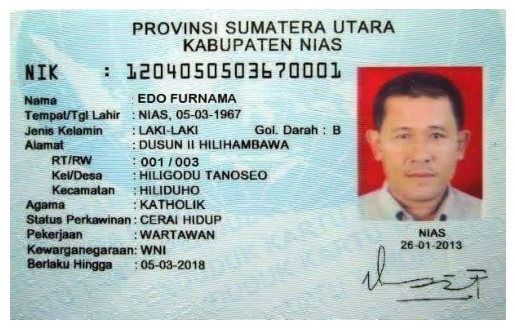

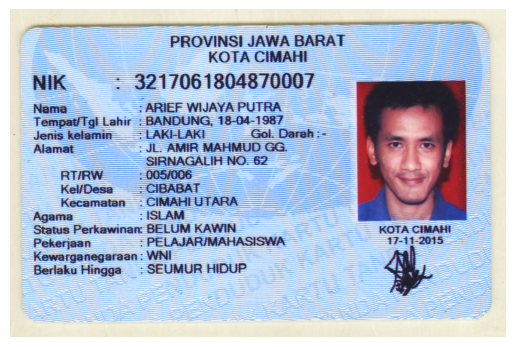

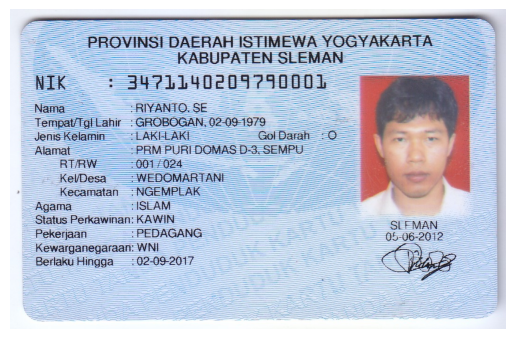

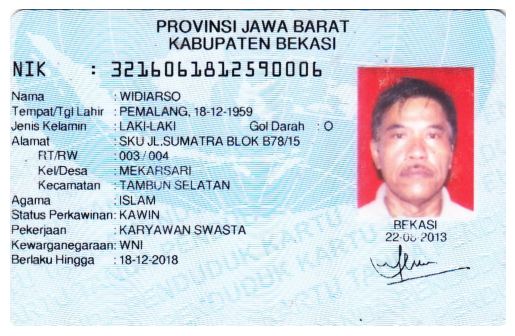

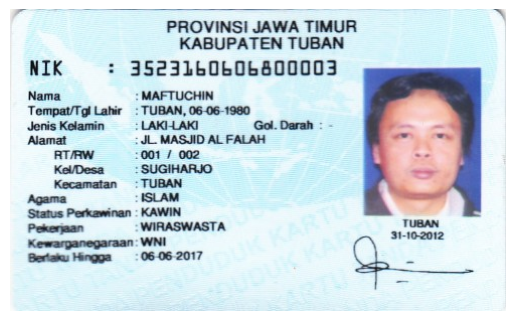

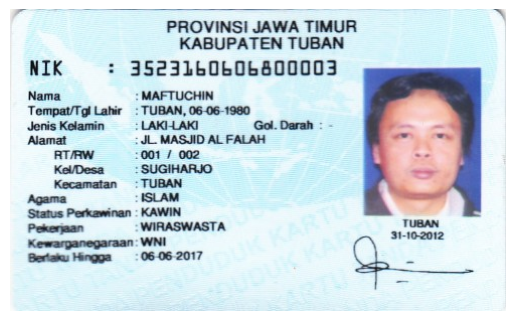

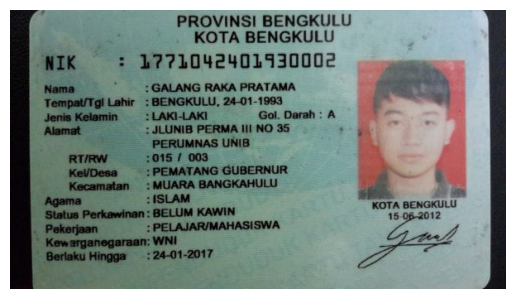

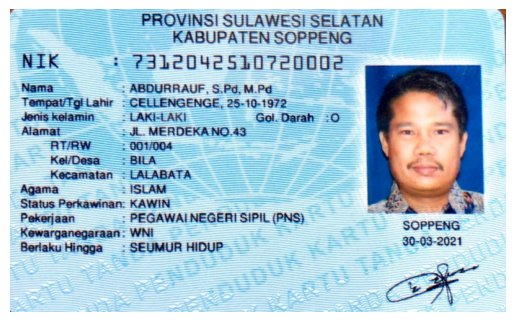

In [88]:
folder_path = '/content/drive/MyDrive/PCVK/KTP/'

# Dapatkan daftar file citra dalam folder
ktp_files = [file for file in os.listdir(folder_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]
# Iterasi pada gambar-gambar KTP
for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(folder_path, ktp_file)
    ktp_image = cv2.imread(ktp_path)

     # Tampilkan gambar
    plt.figure()
    plt.axis('off')
    plt.imshow(cv2.cvtColor(ktp_image, cv2.COLOR_BGR2RGB))
    plt.show()

## Dilasi

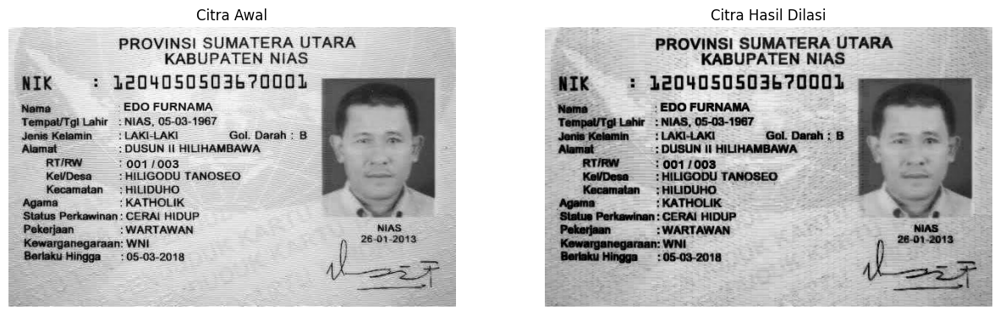

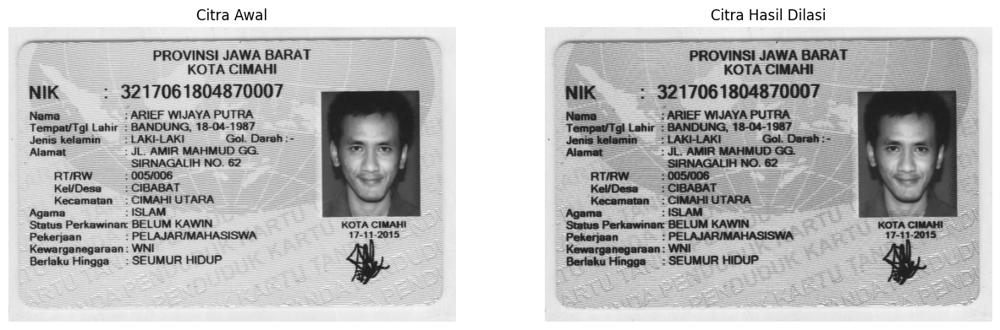

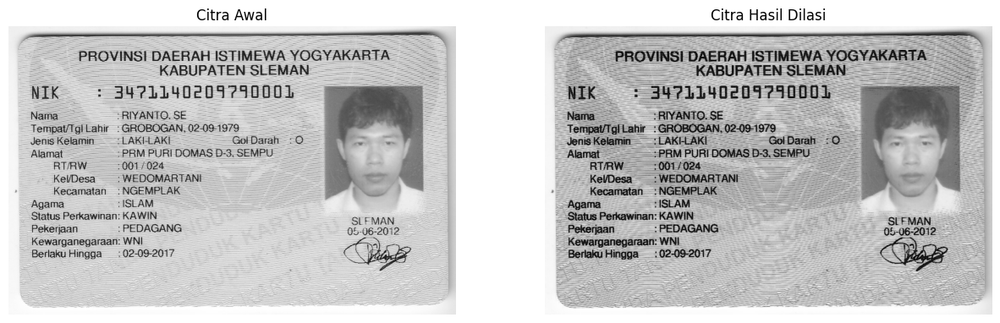

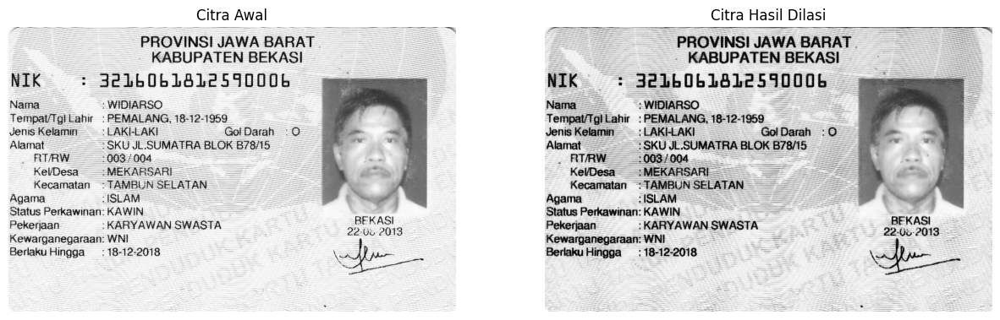

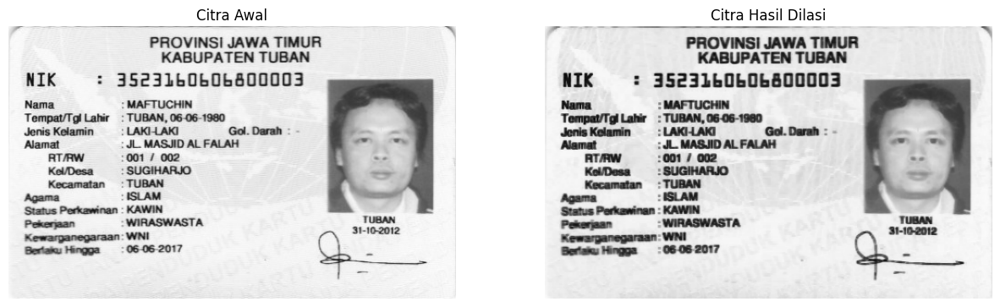

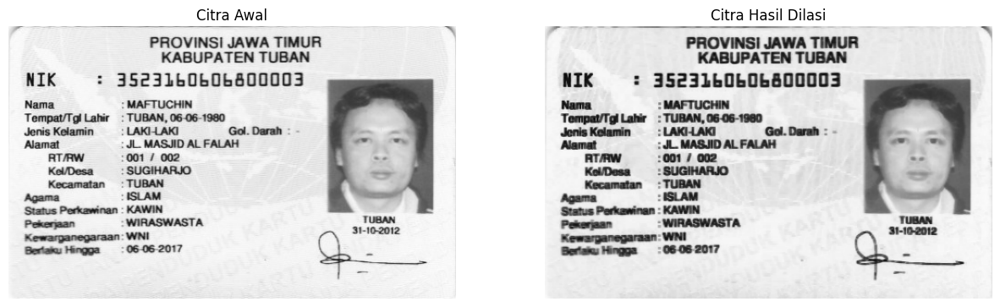

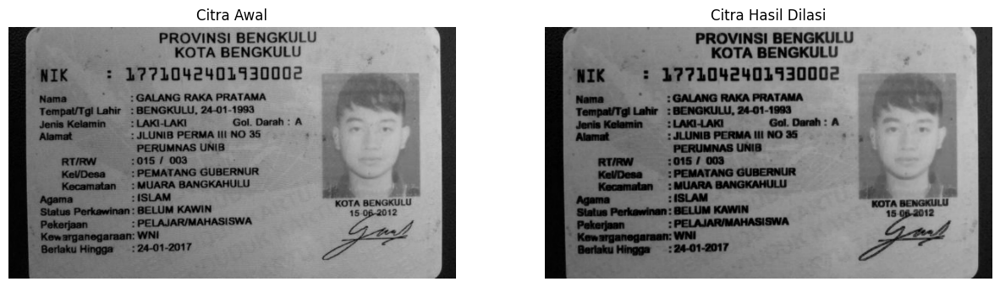

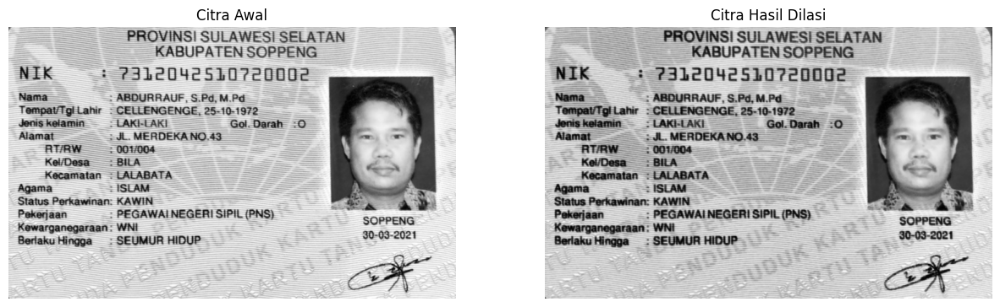

In [125]:
def inverse(image):
  return 255-image

ktp_files = [file for file in os.listdir(folder_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(folder_path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_img = inverse(ktp_image)

    kernel = np.ones((2,2), np.uint8)

    dilation = cv2.morphologyEx(inverse_img, cv2.MORPH_DILATE, kernel)
    dilation_rgb = cv2.cvtColor(dilation, cv2.COLOR_GRAY2RGB)
    plt.figure(figsize=(15,15))
    plt.subplot(121), plt.imshow(cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(dilation_rgb)), plt.title('Citra Hasil Dilasi')
    plt.axis('off')


## Erosi

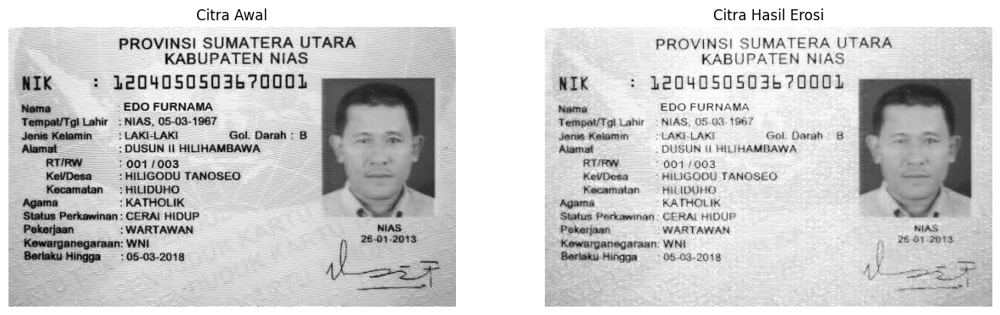

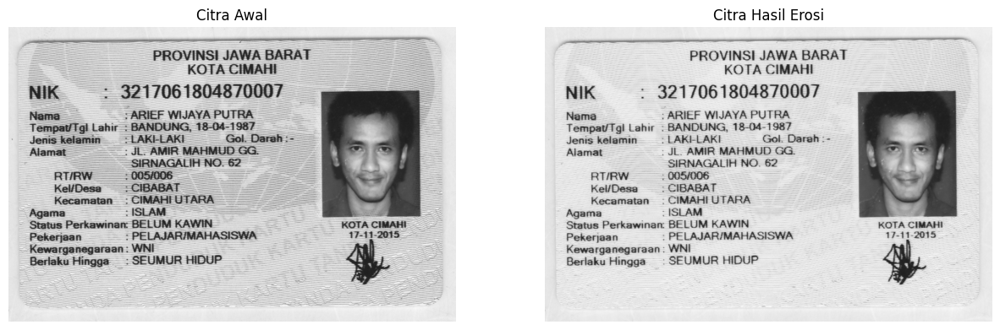

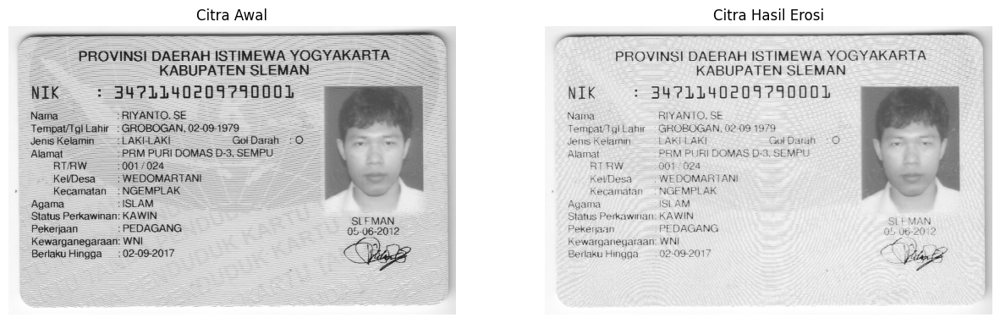

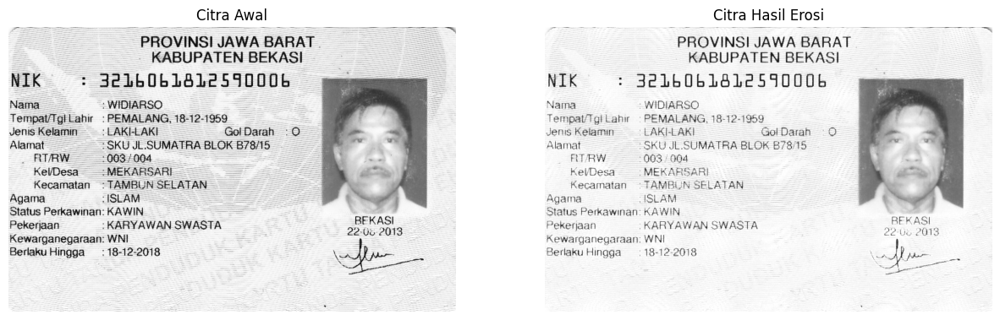

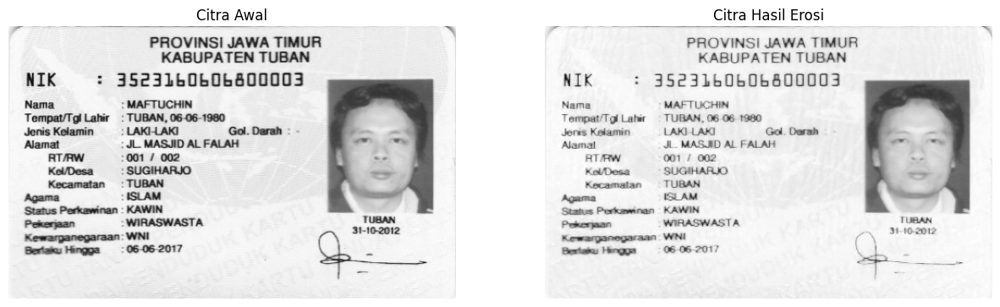

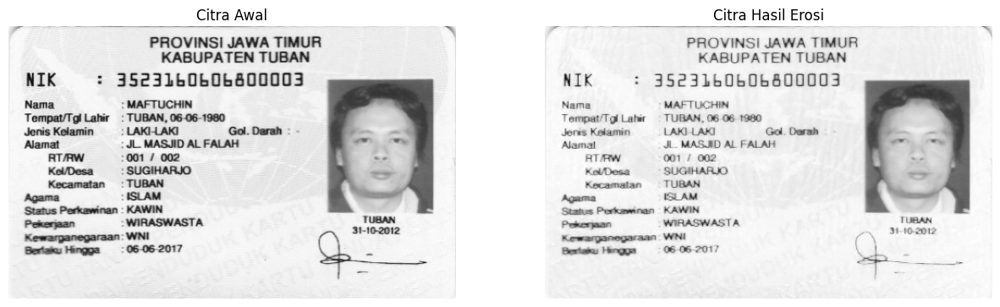

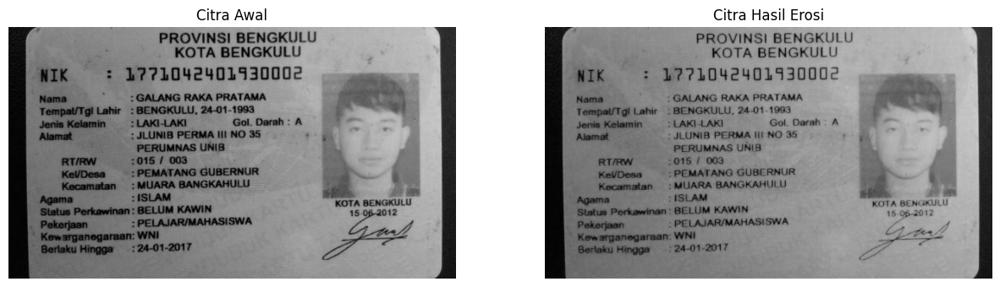

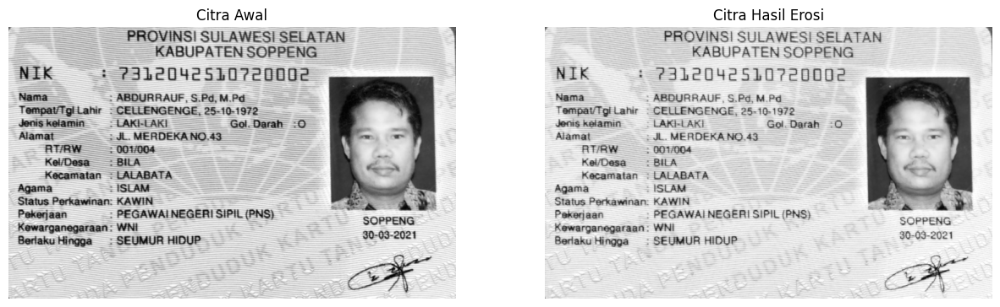

In [124]:
def inverse(image):
  return 255 - image

ktp_files = [file for file in os.listdir(folder_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(folder_path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_image = inverse(ktp_image)

    kernel = np.ones((2,2), np.uint8)

    erosion = cv2.morphologyEx(inverse_image, cv2.MORPH_ERODE, kernel)
    erosion_rgb = cv2.cvtColor(erosion, cv2.COLOR_GRAY2RGB)

    plt.figure(figsize=(15,15))
    plt.subplot(121), plt.imshow(cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(erosion_rgb)), plt.title('Citra Hasil Erosi')
    plt.axis('off')

## Opening

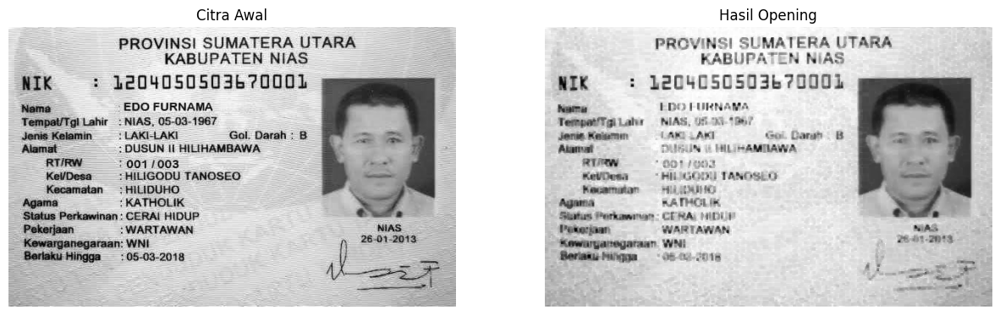

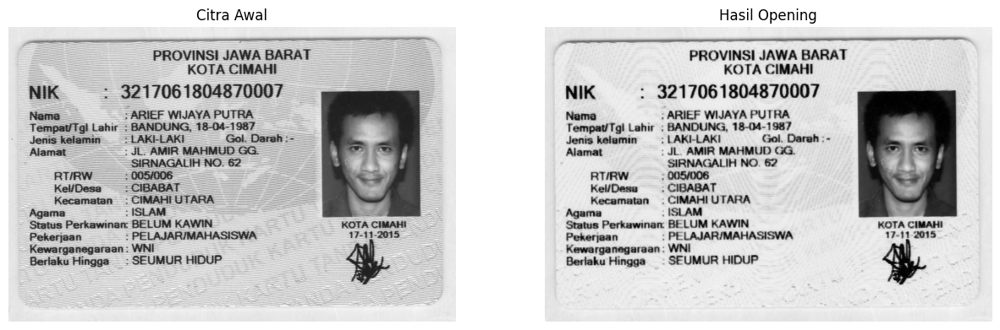

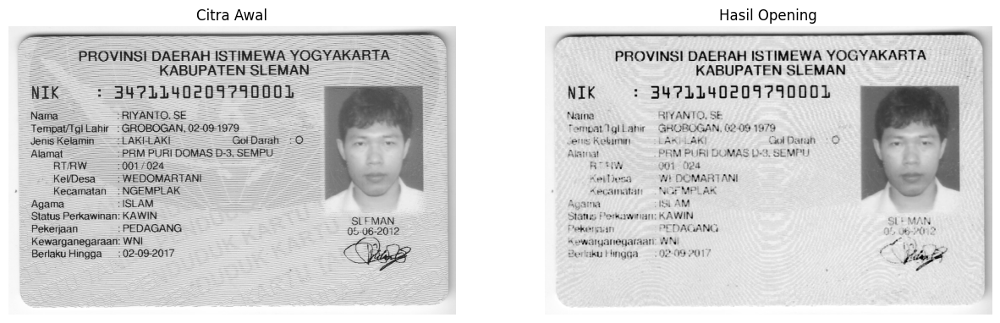

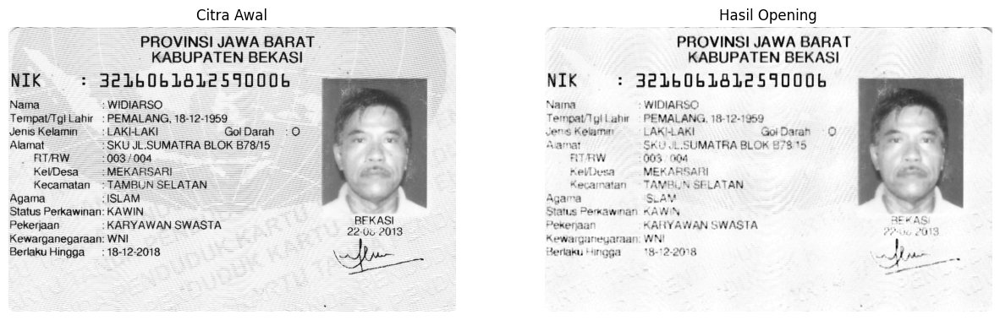

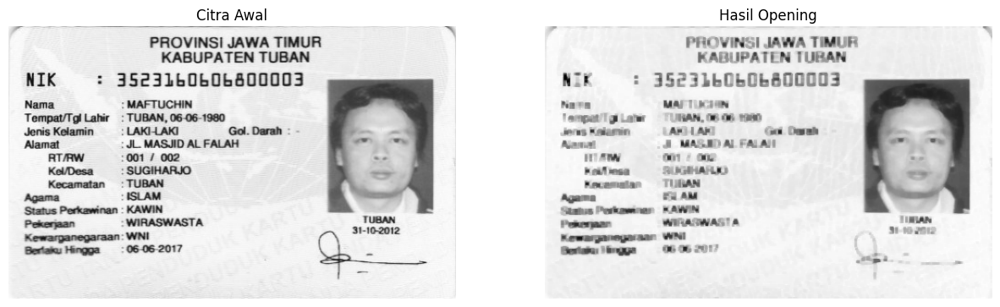

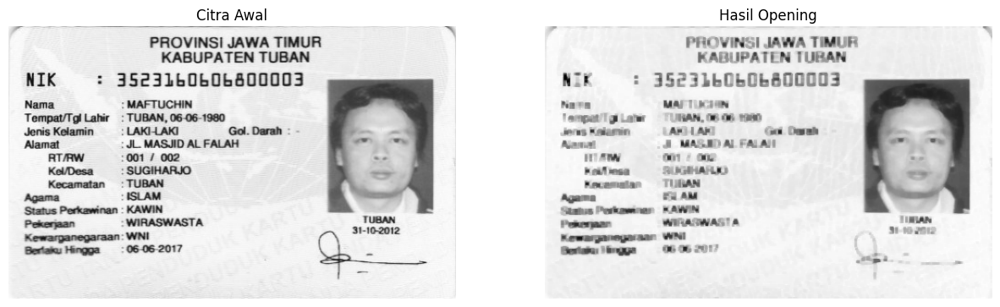

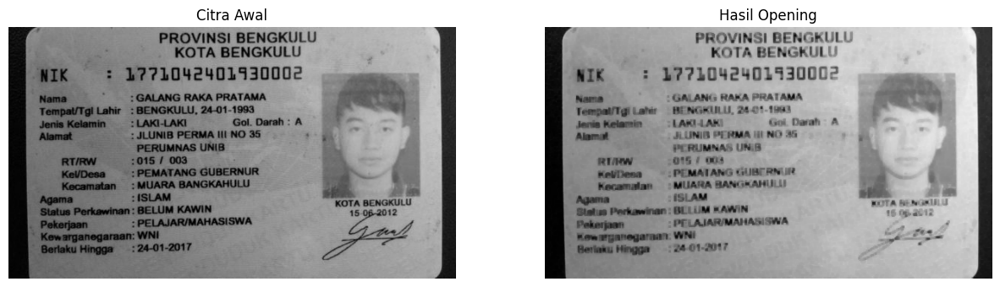

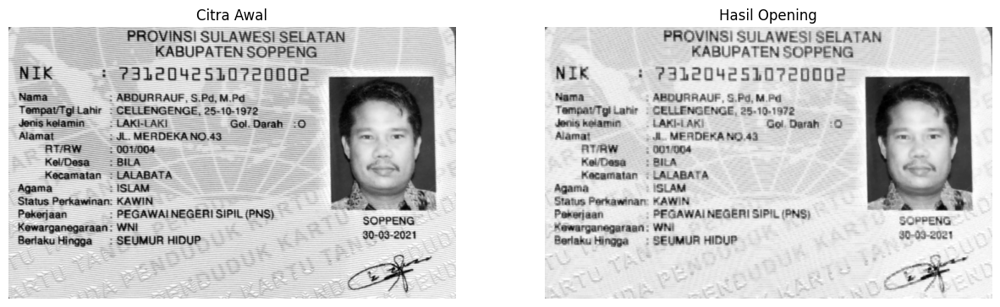

In [121]:
def inverse(image):
  return 255-image

# Baca citra
ktp_files = [file for file in os.listdir(folder_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]


for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(folder_path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_img = inverse(ktp_image)

    se = np.ones((3, 3), dtype=np.uint8)

    # Lakukan erosi dengan SE 3x3
    eroded_image = cv2.erode(inverse_img, se, iterations=1)

    # Lakukan dilasi dengan SE 3x3 pada hasil erosi
    opening_image = cv2.dilate(eroded_image, se, iterations=1)

    ktp_rgb = cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)

    plt.figure(figsize=(15,15))

    # Menampilkan citra awal dan hasil opening
    plt.subplot(121), plt.imshow(ktp_rgb), plt.title('Citra Awal')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(opening_image), cmap='gray'), plt.title('Hasil Opening')
    plt.axis('off')

plt.show()

## Closing

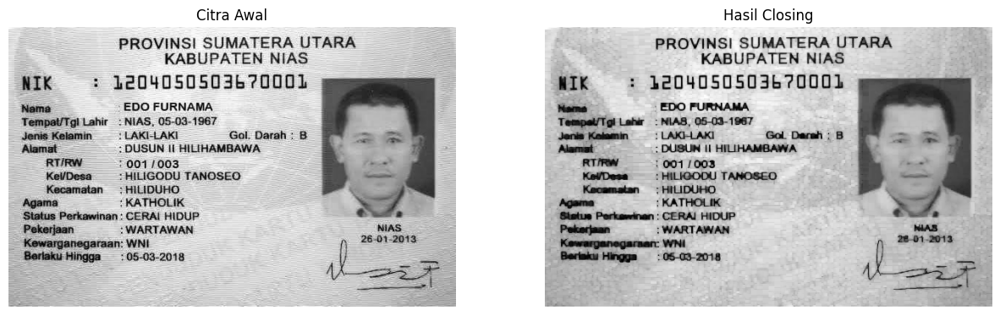

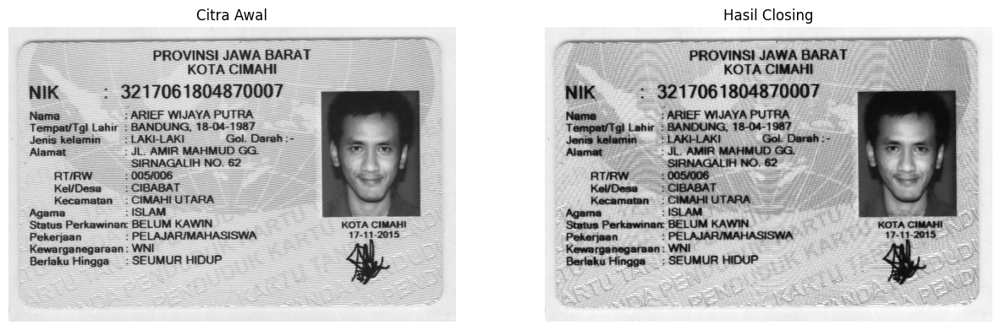

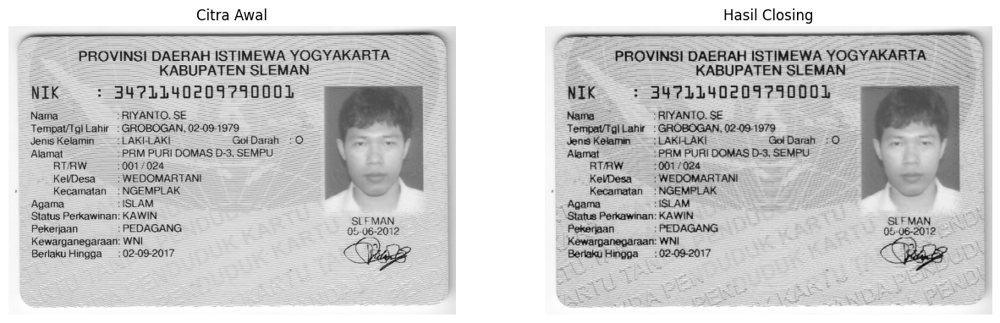

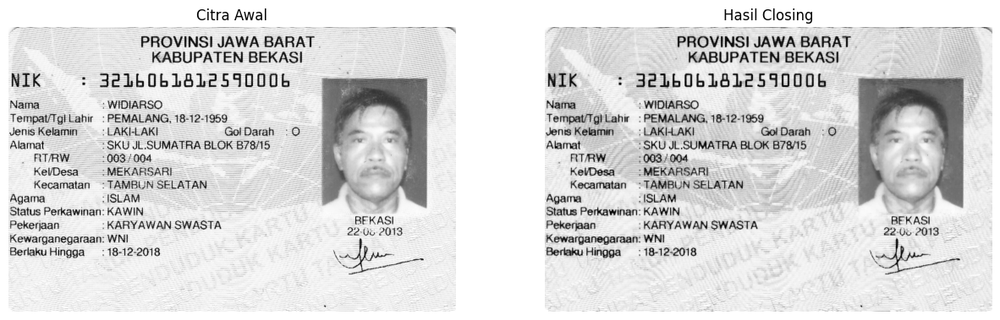

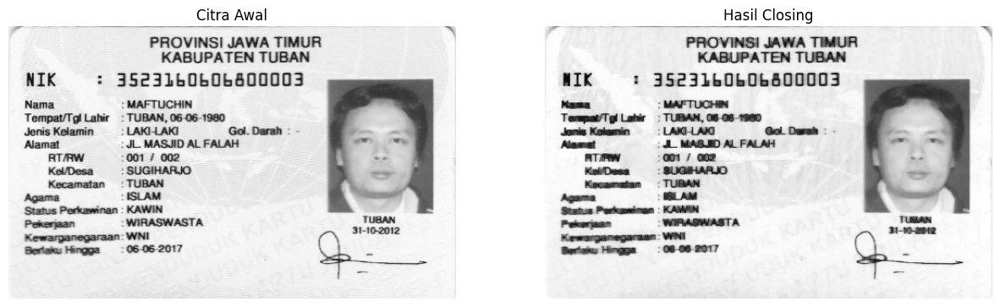

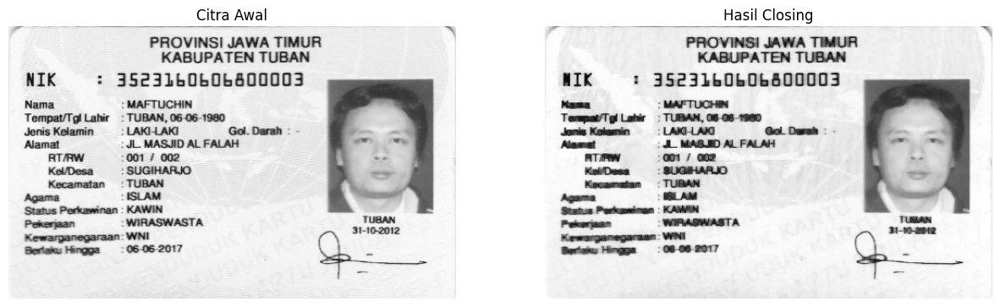

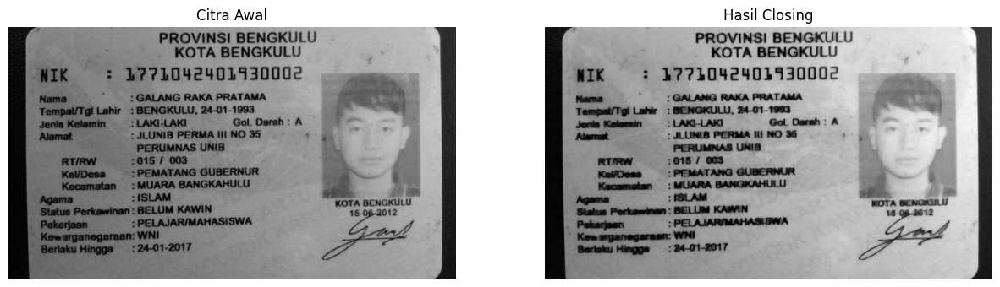

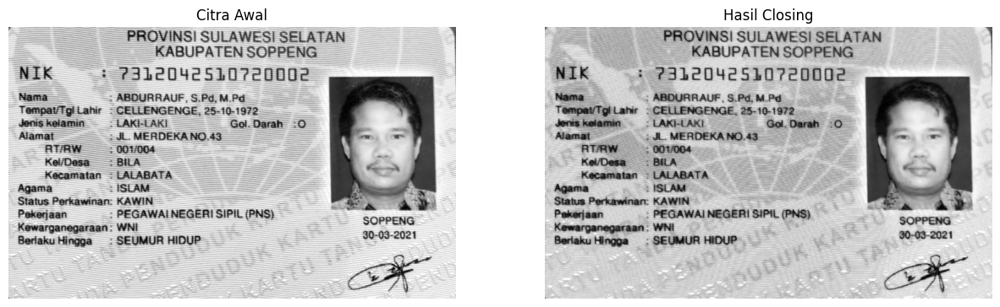

In [120]:
def inverse(image):
  return 255-image

# Baca citra
ktp_files = [file for file in os.listdir(folder_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]


for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(folder_path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_img = inverse(ktp_image)

    se = np.ones((3, 3), dtype=np.uint8)

    # Lakukan erosi dengan SE 3x3
    dilated_image = cv2.dilate(inverse_img, se, iterations=1)

    # Lakukan dilasi dengan SE 3x3 pada hasil erosi
    closing_image = cv2.erode(dilated_image, se, iterations=1)

    ktp_rgb = cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)

    plt.figure(figsize=(15,15))

    # Menampilkan citra awal dan hasil opening
    plt.subplot(121), plt.imshow(ktp_rgb), plt.title('Citra Awal')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(closing_image), cmap='gray'), plt.title('Hasil Closing')
    plt.axis('off')

plt.show()

(-0.5, 492.5, 299.5, -0.5)

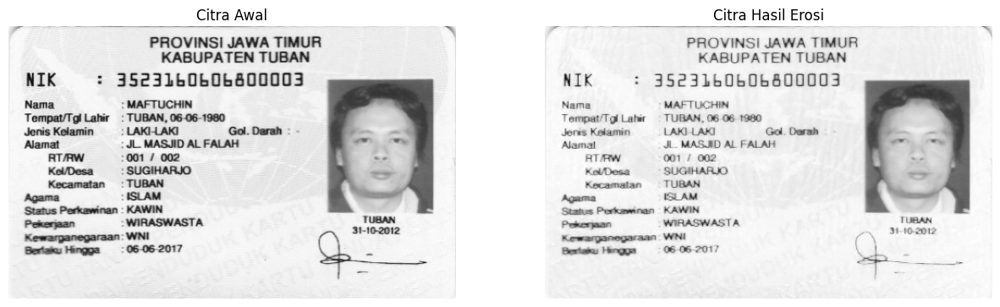

In [119]:
def inverse(image):
  return 255-image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/KTP/ktp3.png', cv2.IMREAD_GRAYSCALE)
inverse_img = inverse(image)

kernel = np.ones((2,2), np.uint8)

erosion = cv2.morphologyEx(inverse_img, cv2.MORPH_ERODE, kernel)
erosion_rgb = cv2.cvtColor(erosion, cv2.COLOR_GRAY2RGB)

plt.figure(figsize=(15,15))

plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(inverse(erosion_rgb)), plt.title('Citra Hasil Erosi')
plt.axis('off')

# Coba-coba

## Opening Tanpa Library dengan SE Square Erosi 7 x 7 dan SE Square Dilasi 3 x 3

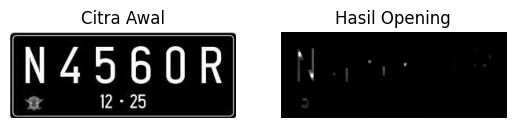

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def erosi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Erosi (SE) berbentuk square 5x5
    se = np.ones((7, 7), dtype=np.uint8)

    # Buat citra hasil erosi dengan inisialisasi citra yang semuanya hitam
    eroded_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan erosi
    for i in range(3, height - 3):
        for j in range(3, width - 3):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-3:i+4, j-3:j+4]
            product = roi * se
            eroded_image[i, j] = np.min(roi)
    return eroded_image

def dilasi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Dilasi (SE) berbentuk square 3x3
    se = np.ones((3, 3), dtype=np.uint8)

    # Buat citra hasil dilasi dengan inisialisasi citra yang semuanya hitam
    dilated_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan dilasi
    for i in range(1, height - 1):
        for j in range(1, width - 1):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-1:i+2, j-1:j+2]
            dilated_image[i, j] = np.max(roi * se)

    return dilated_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi erosi
eroded_image = erosi(image)

# Panggil fungsi dilasi pada hasil erosi
opened_image = dilasi(eroded_image)

# Menampilkan citra awal dan hasil opening
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(opened_image, cmap='gray'), plt.title('Hasil Opening')
plt.axis('off')

plt.show()


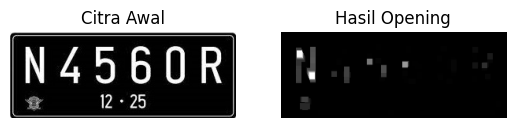

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def erosi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Erosi (SE) berbentuk square 5x5
    se = np.ones((7, 7), dtype=np.uint8)

    # Buat citra hasil erosi dengan inisialisasi citra yang semuanya hitam
    eroded_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan erosi
    for i in range(3, height - 3):
        for j in range(3, width - 3):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-3:i+4, j-3:j+4]
            product = roi * se
            eroded_image[i, j] = np.min(roi)
    return eroded_image

def dilasi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Dilasi (SE) berbentuk square 3x3
    se = np.ones((7, 7), dtype=np.uint8)

    # Buat citra hasil dilasi dengan inisialisasi citra yang semuanya hitam
    dilated_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan dilasi
    for i in range(3, height - 3):
        for j in range(3, width - 3):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-3:i+4, j-3:j+4]
            dilated_image[i, j] = np.max(roi * se)

    return dilated_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi erosi
eroded_image = erosi(image)

# Panggil fungsi dilasi pada hasil erosi
opened_image = dilasi(eroded_image)

# Menampilkan citra awal dan hasil opening
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(opened_image, cmap='gray'), plt.title('Hasil Opening')
plt.axis('off')

plt.show()


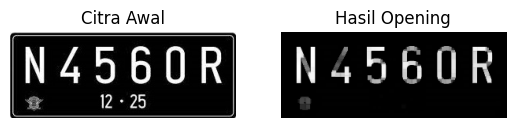

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def erosi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Erosi (SE) berbentuk square 5x5
    se = np.ones((5, 5), dtype=np.uint8)

    # Buat citra hasil erosi dengan inisialisasi citra yang semuanya hitam
    eroded_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan erosi
    for i in range(2, height - 2):
        for j in range(2, width - 2):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-2:i+3, j-2:j+3]
            product = roi * se
            eroded_image[i, j] = np.min(roi)
    return eroded_image

def dilasi(image):
    # Ambil dimensi citra
    height, width = image.shape[:2]

    # Buat Structuring Element Dilasi (SE) berbentuk square 3x3
    se = np.ones((5, 5), dtype=np.uint8)

    # Buat citra hasil dilasi dengan inisialisasi citra yang semuanya hitam
    dilated_image = np.zeros((height, width), dtype=np.uint8)

    # Looping untuk melakukan dilasi
    for i in range(2, height - 2):
        for j in range(2, width - 2):
            # Ambil bagian citra yang sesuai dengan ukuran SE
            roi = image[i-2:i+3, j-2:j+3]
            dilated_image[i, j] = np.max(roi * se)

    return dilated_image

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/plat nomer.jpg', cv2.IMREAD_GRAYSCALE)

# Panggil fungsi erosi
eroded_image = erosi(image)

# Panggil fungsi dilasi pada hasil erosi
opened_image = dilasi(eroded_image)

# Menampilkan citra awal dan hasil opening
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
plt.axis('off')
plt.subplot(122), plt.imshow(opened_image, cmap='gray'), plt.title('Hasil Opening')
plt.axis('off')

plt.show()


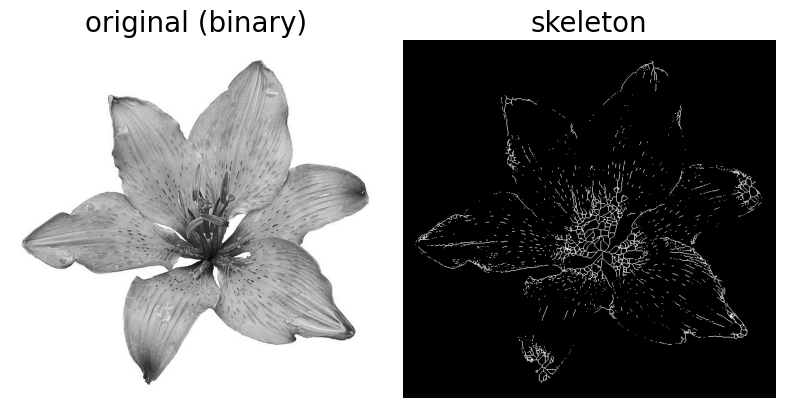

In [23]:
from skimage.morphology import skeletonize
import cv2
import matplotlib.pyplot as plt
from skimage.util import invert

# Baca citra
image_lily = cv2.imread('/content/drive/MyDrive/PCVK/Images/lily.jpg', cv2.IMREAD_GRAYSCALE)

# Invert the horse image
image = invert(image_lily)

# Konversi citra menjadi biner (hitam putih)
ret, binary_image = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)

# perform skeletonization
skeleton = skeletonize(binary_image / 255)  # Membagi oleh 255 untuk mendapatkan citra biner

# display results
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 4),
                         sharex=True, sharey=True)

ax = axes.ravel()

ax[0].imshow(cv2.cvtColor(image_lily,cv2.COLOR_GRAY2RGB))
ax[0].axis('off')
ax[0].set_title('original (binary)', fontsize=20)

ax[1].imshow(skeleton, cmap=plt.cm.gray)
ax[1].axis('off')
ax[1].set_title('skeleton', fontsize=20)

fig.tight_layout()
plt.show()


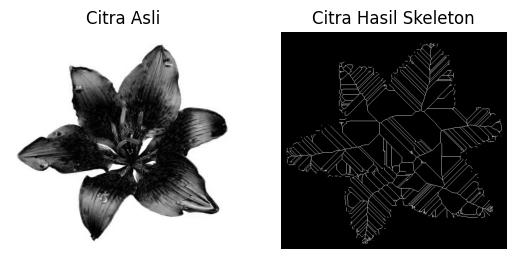

In [45]:
from skimage import filters
from skimage.morphology import skeletonize

# Baca citra
image = cv2.imread('/content/drive/MyDrive/PCVK/Images/lily.jpg')[...,0]

#     return skel
# Note: we want the black bits to be True, so use <
binary_image = image < filters.threshold_triangle(image)
# Jalankan operasi skeleton pada citra biner
skeleton_image = skeletonize(binary_image)

# Menampilkan citra asli dan hasil operasi skeleton
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Asli')
plt.axis('off')
plt.subplot(122), plt.imshow(skeleton_image, cmap='gray'), plt.title('Citra Hasil Skeleton')
plt.axis('off')

plt.show()

